## Fine-tuning Stable Diffusion XL with DreamBooth and LoRA on a free-tier Kaggle Notebook

Resources: 
- https://github.com/huggingface/notebooks/blob/main/diffusers/SDXL_DreamBooth_LoRA_.ipynb
- https://github.com/huggingface/diffusers/blob/main/docs/source/en/using-diffusers/sdxl.md
- https://github.com/huggingface/diffusers/tree/main/examples/dreambooth
- https://github.com/huggingface/diffusers/blob/main/docs/source/en/using-diffusers/sdxl.md#image-to-image

This script is designed to use the fine-tuned models to simulate a trial with 10 patients, each having 140 generated images, demonstrating the efficacy and personalized capability of the models in a clinical or research setting.

## Setup 🪓

In [2]:
# Check the GPU
!nvidia-smi

Mon Mar 25 09:04:17 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.129.03             Driver Version: 535.129.03   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
# Install dependencies.
!pip install bitsandbytes transformers tqdm peft xformers invisible-watermark>=0.2.0 -q

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
fastai 2.7.13 requires torch<2.2,>=1.10, but you have torch 2.2.1 which is incompatible.


Make sure to install `diffusers` from `main`.

In [4]:
!pip install git+https://github.com/huggingface/diffusers.git -q

Let's generate some images with it!

## Inference for all images in a study protocol

In [ ]:
import pandas as pd
import torch
from diffusers import AutoPipelineForImage2Image, AutoencoderKL, UniPCMultistepScheduler
from diffusers.utils import make_image_grid
from pathlib import Path
import random
from PIL import Image, ImageDraw
from tqdm.auto import tqdm
import os
import glob
import zipfile

In [23]:
# Delete all images in the output folder
output_path = '/kaggle/working'
for file_path in glob.glob(os.path.join(output_path, '*')):
    os.remove(file_path)

In [24]:
# Input and output Paths
input_path = '/kaggle/input'
output_path = '/kaggle/working'

# Load CSV
csv_path = f'{input_path}/acne04/sim_acne.csv'
df = pd.read_csv(csv_path)

# Round AcneSeverity to the nearest whole number and cap at 3
df['ModelSeverity'] = df['AcneSeverity'].apply(lambda x: min(round(x), 3)).astype(int)

# Initialize a dictionary to store patient ID to random image path mapping
patient_image_map = {}

# Define folder for input images with severity level 0
image_folder_path = Path(f'{input_path}/acne04/acne_1024/acne0_1024')

# Load a random image for each patient ID
patient_image_map = {
    patient_id: random.choice(list(image_folder_path.glob('*.jpg')))
    for patient_id in df['patient_id'].unique()
}

# Function to pick a random image for each patient ID
def pick_random_images(df, image_folder_path):
    patient_image_map = {}
    unique_patient_ids = df['patient_id'].unique()
    image_files = list(image_folder_path.glob('*.jpg'))
    for patient_id in unique_patient_ids:
        random_image_path = random.choice(image_files)
        patient_image_map[patient_id] = random_image_path
    return patient_image_map

device = "cuda" if torch.cuda.is_available() else "cpu"

vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)

# Function to load model and generate image
def generate_images_for_severity_level(severity_level, grouped_df, patient_image_map):
    model_name = f"ManuelHettich/acne{severity_level}_LoRA_filtered_all"
    pipe = AutoPipelineForImage2Image.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0",
                                                        vae=vae,
                                                        torch_dtype=torch.float16,
                                                        variant="fp16",
                                                        use_safetensors=True)
    pipe.load_lora_weights(model_name)
    
    pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

    # improve the inference speed by 20-30%
    # pipe.unet = torch.compile(pipe.unet, mode="reduce-overhead", fullgraph=True)

    pipe = pipe.to("cuda")

    # https://huggingface.co/docs/diffusers/main/en/optimization/memory#tiled-vae
    pipe.enable_vae_tiling()

    # https://huggingface.co/docs/diffusers/main/en/optimization/memory#memory-efficient-attention
    pipe.enable_xformers_memory_efficient_attention()
    
    for _, row in tqdm(grouped_df.iterrows(), total=grouped_df.shape[0], desc=f"Processing severity {severity_level}"):
        patient_id = row['patient_id']
        date = row['date'].replace('-', '')
        image_path = patient_image_map[patient_id]
        init_image = Image.open(image_path)
        
        prompt = f"photo of a person with acne{severity_level}, portrait, close-up, cheek, detailed, HQ, photo, 4k"
        
        output_image = pipe(prompt=prompt, image=init_image, strength=0.1, guidance_scale=12, num_inference_steps=30).images[0]
        output_image_path = f"{output_path}/{patient_id}_{date}_severity_{severity_level}.jpg"
        output_image.save(output_image_path)
        print(f"Image saved to {output_image_path}")

# Function to create an image grid for each patient
def create_image_grids(df, output_folder_path):
    for patient_id in tqdm(df['patient_id'].unique(), desc="Creating image grids"):
        patient_images = list(output_folder_path.glob(f'{patient_id}_*.jpg'))
        patient_images.sort() # This assumes the naming convention includes the date in a way that sorting works as expected
        images = [Image.open(image) for image in patient_images]
        
        # Assuming all images are of the same size
        img_width, img_height = images[0].size
        grid_width = 5
        grid_height = len(images) // grid_width + (1 if len(images) % grid_width else 0)
        
        grid = Image.new('RGB', (img_width * grid_width, img_height * grid_height))
        for index, image in enumerate(images):
            row = index // grid_width
            col = index % grid_width
            grid.paste(image, (col * img_width, row * img_height))
        
        grid.save(f"{output_path}/grid_{patient_id}.jpg")
        print(f"Grid saved for patient {patient_id}")        

def zip_images_in_folder(folder_path, filename):
    """
    Archives all images in the specified folder into a zip file.
    
    Args:
    - folder_path (str): The path to the folder containing images to be zipped.
    - filename (str): The name of the output zip file without the extension.
    """
    with zipfile.ZipFile(filename, "w", zipfile.ZIP_DEFLATED) as zip_file:
        for entry in folder_path.rglob("*.jpg"):
            zip_file.write(entry, entry.relative_to(folder_path))      

In [ ]:
# Main execution
patient_image_map = pick_random_images(df, image_folder_path)
for severity_level, group_df in df.groupby('ModelSeverity'):
    generate_images_for_severity_level(severity_level, group_df, patient_image_map)
create_image_grids(df, Path(output_path))
zip_images_in_folder(Path(output_path), 'generated_images.zip')

## Inference for single images

In [4]:
import os
os.chdir("/kaggle/working")

In [13]:
# Lower memory usage
# https://huggingface.co/docs/diffusers/main/en/optimization/memory
# https://huggingface.co/stabilityai/stable-diffusion-xl-base-1.0
import os
os.environ['PYTORCH_CUDA_ALLOC_CONF'] = 'max_split_size_mb:128'

### Txt2Img

In [14]:
import torch
from diffusers import DiffusionPipeline, AutoencoderKL
from diffusers.utils import make_image_grid

device = "cuda" if torch.cuda.is_available() else "cpu"

vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)
pipe = DiffusionPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    vae=vae,
    torch_dtype=torch.float16,
    variant="fp16",
    use_safetensors=True
)
pipe.load_lora_weights(repo_id)
_ = pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

pytorch_lora_weights.safetensors:   0%|          | 0.00/23.4M [00:00<?, ?B/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

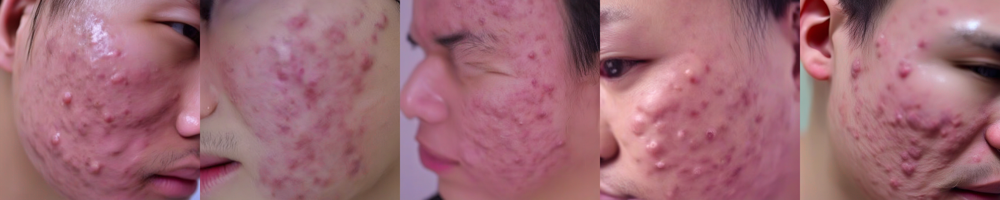

In [9]:
prompt = "photo of a person with acne3, portrait, close-up, cheek, detailed, HQ, photo, 4k" # @param
images = []

for _ in range(5):
    image = pipe(prompt=prompt, num_inference_steps=25).images[0]
    images.append(image)

make_image_grid(images, rows=1, cols=5)

### Img2Img

In [15]:
import torch
from diffusers import AutoPipelineForImage2Image, AutoencoderKL, UniPCMultistepScheduler
from diffusers.utils import load_image, make_image_grid

# Image-to-Image
# https://github.com/huggingface/diffusers/blob/main/docs/source/en/using-diffusers/sdxl.md#image-to-image

# vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)
# pipe = AutoPipelineForImage2Image.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0",
#                                                   vae=vae,
#                                                   torch_dtype=torch.float16,
#                                                   variant="fp16",
#                                                   use_safetensors=True)
# pipe.load_lora_weights(repo_id)

pipe = AutoPipelineForImage2Image.from_pipe(pipe)

# _ = pipe.to("cuda")
# Remove limitation by GPU VRAM
# _ = pipe.enable_model_cpu_offload()

pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

# improve the inference speed by 20-30%
# pipe.unet = torch.compile(pipe.unet, mode="reduce-overhead", fullgraph=True)

pipe = pipe.to("cuda")

# https://huggingface.co/docs/diffusers/main/en/optimization/memory#tiled-vae
pipe.enable_vae_tiling()

# https://huggingface.co/docs/diffusers/main/en/optimization/memory#memory-efficient-attention
pipe.enable_xformers_memory_efficient_attention()

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

  0%|          | 0/18 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/24 [00:00<?, ?it/s]

  0%|          | 0/27 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

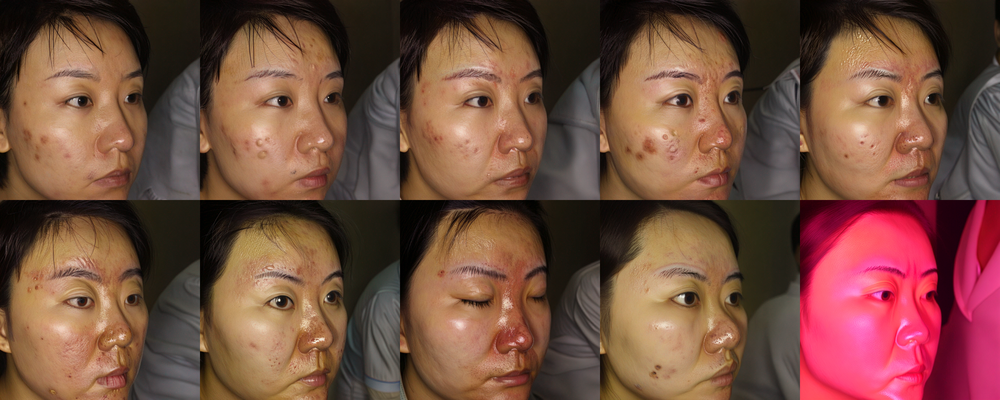

In [16]:
images = []
with torch.inference_mode():
    # url = "https://mymodernmet.com/wp/wp-content/uploads/2019/09/100k-ai-faces-3.jpg"
    url = "/kaggle/input/acne04/acne0_1024/levle0_1.jpg"
    init_image = load_image(url)
    prompt = "photo of a person with acne0, portrait, close-up, cheek, detailed, HQ, photo, 4k"
    # https://huggingface.co/docs/diffusers/v0.3.0/en/api/pipelines/stable_diffusion
    # strength (float, optional, defaults to 0.8) — Conceptually, indicates how much to transform the reference init_image.
    # Must be between 0 and 1. init_image will be used as a starting point, adding more noise to it the larger the strength.
    # The number of denoising steps depends on the amount of noise initially added. When strength is 1, added noise will be
    # maximum and the denoising process will run for the full number of iterations specified in num_inference_steps. A value
    # of 1, therefore, essentially ignores init_image.
    # guidance_scale (float, optional, defaults to 7.5) — Guidance scale as defined in Classifier-Free Diffusion Guidance.
    # guidance_scale is defined as w of equation 2. of Imagen Paper. Guidance scale is enabled by setting guidance_scale > 1.
    # Higher guidance scale encourages to generate images that are closely linked to the text prompt, usually at the expense
    # of lower image quality.
    
    for strength in range(1, 11, 1):
        image = pipe(prompt, image=init_image, strength=strength/10, guidance_scale=12, num_inference_steps=30).images[0]
        images.append(image)
    # make_image_grid([init_image, image], rows=1, cols=2)

make_image_grid(images, rows=2, cols=5)

In [ ]:
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import load_image, make_image_grid

# Image-to-Image
# https://github.com/huggingface/diffusers/blob/main/docs/source/en/using-diffusers/sdxl.md#image-to-image

# use from_pipe to avoid consuming additional memory when loading a checkpoint
pipeline = AutoPipelineForImage2Image.from_pipe(pipe).to("cuda")

url = "https://images.unsplash.com/photo-1500648767791-00dcc994a43e?ixlib=rb-4.0.3&q=85&fm=jpg&crop=entropy&cs=srgb&dl=jurica-koletic-7YVZYZeITc8-unsplash.jpg&w=1920"
init_image = load_image(url)
prompt = "a person with acne1, full portrait, high quality"
image = pipeline(prompt, image=init_image, strength=0.8, guidance_scale=10.5).images[0]
make_image_grid([init_image, image], rows=1, cols=2)

# All-in-one model (SD1.5)

In [1]:
!pip install -q diffusers transformers accelerate invisible-watermark>=0.2.0

In [3]:
import os
from huggingface_hub import whoami
from pathlib import Path
from kaggle_secrets import UserSecretsClient
user_secrets = UserSecretsClient()
os.environ["HF_TOKEN"] = user_secrets.get_secret("hf_write_token")
repo_id = "ManuelHettich/acne_sd1.5_fast-dreambooth_filtered_small"

## Txt2Img

vae/diffusion_pytorch_model.safetensors not found

A mixture of fp16 and non-fp16 filenames will be loaded.
Loaded fp16 filenames:
[safety_checker/pytorch_model.fp16.bin]
Loaded non-fp16 filenames:
[vae/diffusion_pytorch_model.bin, unet/diffusion_pytorch_model.bin, text_encoder/pytorch_model.bin
If this behavior is not expected, please check your folder structure.


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

safety_checker/config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/246M [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/621 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

pytorch_model.fp16.bin:   0%|          | 0.00/608M [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/346 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/639 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/335M [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/torch/_utils.py:831: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()


  0%|          | 0/50 [00:00<?, ?it/s]

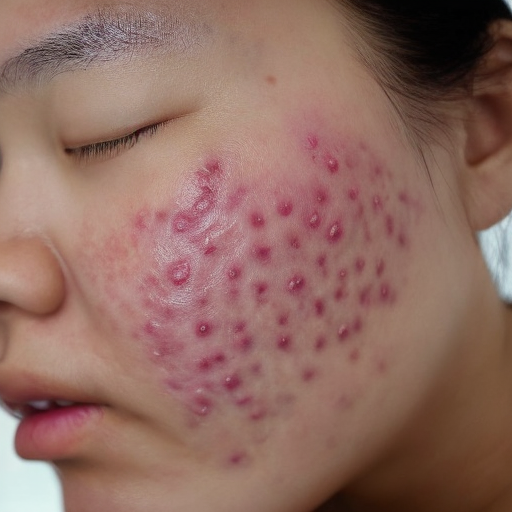

In [5]:
from diffusers import AutoPipelineForText2Image
import torch

pipeline_text2image = AutoPipelineForText2Image.from_pretrained(
    repo_id, torch_dtype=torch.float16, variant="fp16").to("cuda")

  0%|          | 0/50 [00:00<?, ?it/s]

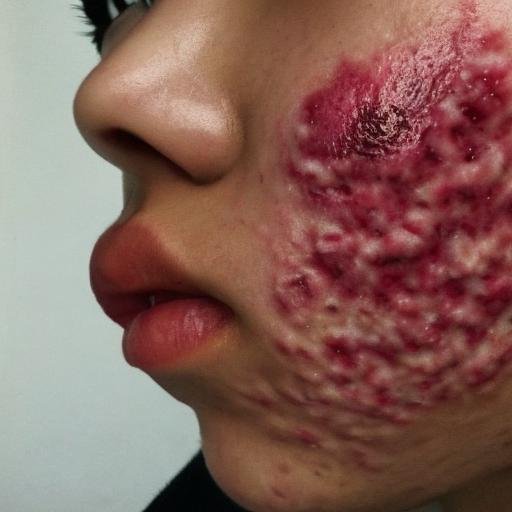

In [11]:
prompt = "photo of a person with acnesmall, close-up, full face, portrait, high quality, photorealistic, detailed, 8k"
image = pipeline_text2image(prompt=prompt).images[0]
image

## Img2Img

In [12]:
from diffusers import AutoPipelineForImage2Image
from diffusers.utils import load_image, make_image_grid

# use from_pipe to avoid consuming additional memory when loading a checkpoint
pipeline_image2image = AutoPipelineForImage2Image.from_pipe(pipeline_text2image).to("cuda")

  0%|          | 0/25 [00:00<?, ?it/s]

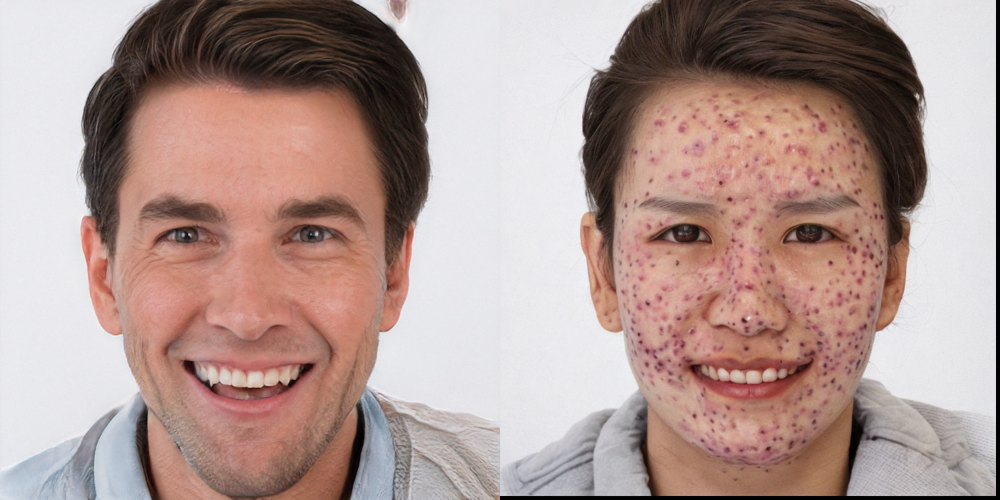

In [26]:
url = "https://mymodernmet.com/wp/wp-content/uploads/2019/09/100k-ai-faces-3.jpg"
init_image = load_image(url)
prompt = "photo of a person with acnestrong, close-up, full face, portrait, high quality, photorealistic, detailed, 8k"
image = pipeline_image2image(prompt, image=init_image, strength=0.5, guidance_scale=8).images[0]
make_image_grid([init_image, image], rows=1, cols=2)